# Predicting fluxes on grid


In [1]:
import sys
import xarray as xr
import numpy as np
import pandas as pd
from joblib import load
from matplotlib import pyplot as plt

import warnings
warnings.filterwarnings("ignore")

sys.path.append('/g/data/os22/chad_tmp/AusEFlux/src/')
from _prediction import collect_prediction_data, predict_xr, HiddenPrints
from _utils import start_local_dask, round_coords

In [2]:
client = start_local_dask(mem_safety_margin='2Gb')
client

distributed.nanny.memory - WARNING - Ignoring provided memory limit 200453487616 due to system memory limit of 95.00 GiB
/g/data/os22/chad_tmp/AusEFlux/env/py310/lib/python3.10/site-packages/dask/config.py:742: FutureWarning: Dask configuration key 'ucx' has been deprecated; please use 'distributed.comm.ucx' instead
  warnings.warn(
/g/data/os22/chad_tmp/AusEFlux/env/py310/lib/python3.10/site-packages/dask/config.py:742: FutureWarning: Dask configuration key 'distributed.scheduler.transition-log-length' has been deprecated; please use 'distributed.admin.low-level-log-length' instead
  warnings.warn(
/g/data/os22/chad_tmp/AusEFlux/env/py310/lib/python3.10/site-packages/dask/config.py:742: FutureWarning: Dask configuration key 'distributed.comm.recent-messages-log-length' has been deprecated; please use 'distributed.admin.low-level-log-length' instead
  warnings.warn(
/g/data/os22/chad_tmp/AusEFlux/env/py310/lib/python3.10/site-packages/dask/config.py:742: FutureWarning: Dask configurati

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 1
Total threads: 24,Total memory: 95.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:38117,Workers: 1
Dashboard: /proxy/8787/status,Total threads: 24
Started: Just now,Total memory: 95.00 GiB
Comm: tcp://127.0.0.1:41299,Total threads: 24
Dashboard: /proxy/36261/status,Memory: 95.00 GiB
Nanny: tcp://127.0.0.1:33925,


## Analysis Parameters

In [3]:
var = 'GPP'
version='20240214'
t1, t2='2003','2022'
base = '/g/data/os22/chad_tmp/AusEFlux/'

### Set up paths

In [4]:
results_name=f'{var}_5km_LGBM_{t1}_{t2}_{version}.nc'
model_path = f'{base}results/models/{var}_LGBM_model_{version}.joblib'
features_list = f'{base}results/variables_{version}.txt'

## Open model

In [5]:
model = load(model_path).set_params(n_jobs=1)

## Open predictor data

In [6]:
## open data
data = collect_prediction_data(data_path=f'{base}/data/5km/',
                             time_range=(t1,t2),
                             verbose=False,
                             export=False,
                             chunks=dict(time=1)
                             )

## Create no-data & urban masks

If we haven't already

In [ ]:
# mask = data[['EVI', 'NDWI', 'VegH', 'SRAD']].to_array().isnull().any('variable')
# mask.compute().to_netcdf(f'{base}data/mask_5km_monthly_{t1}_{t2}.nc')

# #create an urban mask once, then next time load it.
# urban = xr.open_dataarray('/g/data/os22/chad_tmp/NEE_modelling/data/urban_mask_1km.nc')
# urban = urban.odc.reproject(mask.odc.geobox, resampling='mode')
# urban=round_coords(urban)
# urban.name='urban_mask'
# urban = urban.astype(bool).rename({'latitude':'y', 'longitude':'x'})
# urban.compute().to_netcdf(f'{base}data/urban_mask_5km.nc')


In [8]:
mask = xr.open_dataarray(f'{base}data/mask_5km_monthly_{t1}_{t2}.nc')
urban = xr.open_dataset(f'{base}data/urban_mask_5km.nc')['urban_mask']

### Index by variables and check variable order

In [9]:
train_vars = list(pd.read_csv(features_list))[0:-1]
train_vars=[i[:-3] for i in train_vars]

data = data[train_vars]

if train_vars == list(data.data_vars):
    print('Variables match, n:', len(data.data_vars))
else:
    raise ValueError("Variables don't match")

Variables match, n: 22


### Predict each time-step seperately

- TO DO: fix timesteps that come back from `predict_xr`

In [17]:
%%time
import warnings
warnings.filterwarnings("ignore")

results = []
i=0

for i in range(0, len(data.time)): 
    print(" {:03}/{:03}\r".format(i + 1, len(range(0, len(data.time)))), end="")
    with HiddenPrints():
        predicted = predict_xr(model,
                            data.isel(time=i),
                            proba=False,
                            clean=True,
                              ).compute()

    #mask no-data areas
    predicted = predicted.Predictions.where(~mask.isel(time=i))

    #add back time dim
    predicted['time'] = data.isel(time=i).time.values

    #append to list
    results.append(predicted.astype('float32'))
    i+=1 

#join together into a Dataset
ds = xr.concat(results, dim='time').sortby('time').rename(var).astype('float32')

#mask urban areas
ds = ds.where(urban!=1).astype('float32')

CPU times: user 4min 33s, sys: 19.6 s, total: 4min 53s
Wall time: 26min 47s


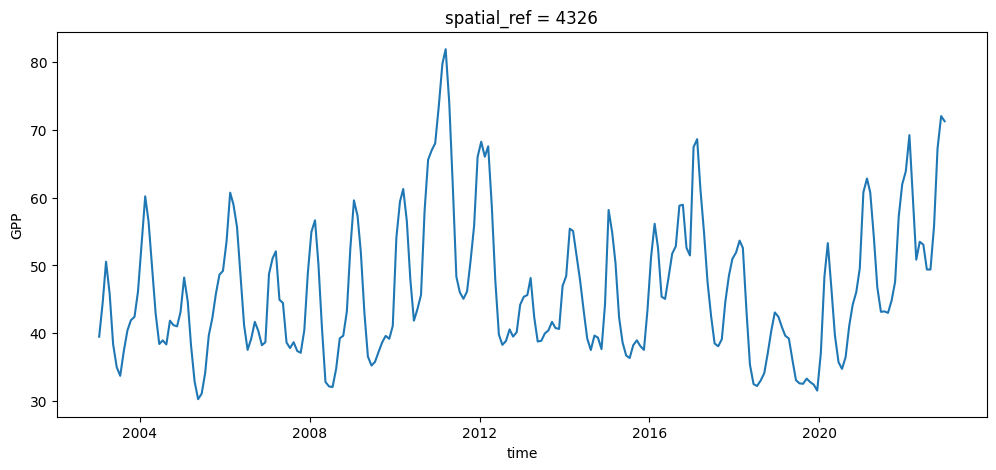

In [18]:
ds.sel(time=slice('2003', '2022')).mean(['x','y']).plot(figsize=(12,5))

In [26]:
# clim_late = ds.sel(time=slice('2003', '2022')).groupby('time.month').mean()

# fig,ax=plt.subplots(1,1)
# clim_late.mean(['x', 'y']).plot(ax=ax,  label='late')
# ax.legend()

### Save results

In [20]:
ds.to_netcdf(f'{base}results/predictions/'+results_name)

## Animate results

In [24]:
import xarray as xr
from IPython.display import Image
import matplotlib.pyplot as plt

import sys
sys.path.append('/g/data/os22/chad_tmp/dea-notebooks/Tools')
from dea_tools.plotting import xr_animation

Exporting animation to /g/data/os22/chad_tmp/AusEFlux/results/gifs/GPP_LGBM_5km_20240214.gif


  0%|          | 0/240 (0.0 seconds remaining at ? frames/s)

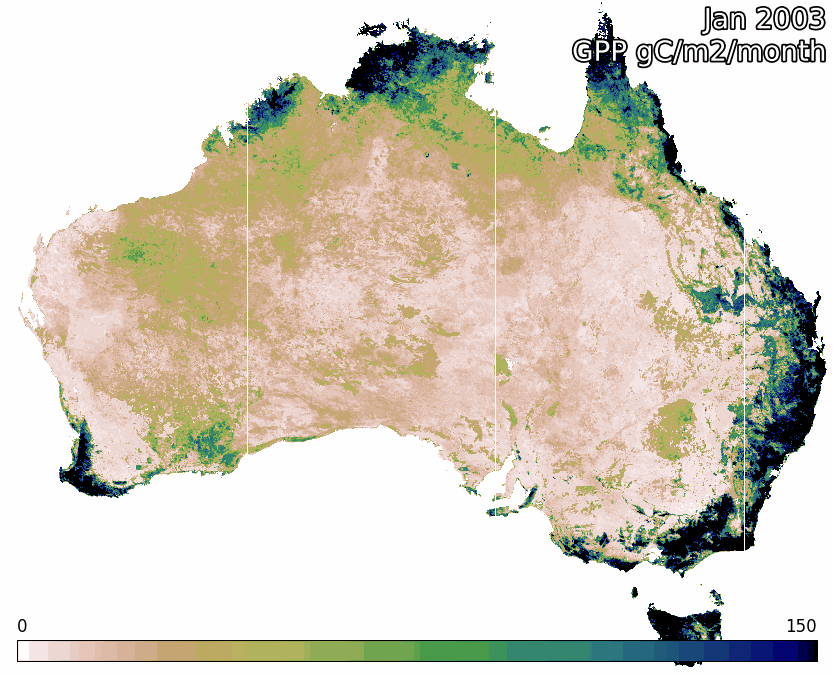

In [25]:
path = f'{base}results/gifs/{var}_LGBM_5km_{version}.gif'

if var=='NEE':
    imshow={'vmin': -45, 'vmax': 45, 'cmap': 'Spectral_r'}
    
else:
    imshow={'vmin': 0, 'vmax': 150, 'cmap': 'gist_earth_r'}

xr_animation(ds.to_dataset().rolling(time=3, min_periods=1).mean(),
            bands=[var],
            show_date='%b %Y',
            width_pixels=600,
            output_path=path,
            show_colorbar=True,
            colorbar_kwargs={'colors': 'black'},
            # show_gdf=poly_gdf,
            interval=150, 
            show_text=var+' gC/m2/month',
            # gdf_kwargs={'edgecolor': 'grey', 'linewidth':0.5}, 
            imshow_kwargs=imshow
            )

# Plot animation
plt.close()
Image(path, embed=True)